In [3]:
import pandas as pd
import geopandas as gpd

In [5]:
metro=gpd.read_file('data/LineServingStops1223.zip')

In [3]:
type(metro)

geopandas.geodataframe.GeoDataFrame

In [4]:
metro.head()

,STOPNUM,LINE,DIR,STOPNAME,LAT,LONG,geometry
0,1,265,S,Paramount / Slauson,33.973248,-118.113113,POINT (-118.11311 33.97325)
1,3,35,N,Jefferson / 10th,34.025471,-118.328402,POINT (-118.32840 34.02547)
2,6,53,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
3,6,120,W,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
4,6,55,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)


In [5]:
metro.tail(1)

,STOPNUM,LINE,DIR,STOPNAME,LAT,LONG,geometry
15088,72000003,720,W,6th / Witmer,34.055547,-118.265321,POINT (-118.26532 34.05555)


In [6]:
metro.sample(2)

,STOPNUM,LINE,DIR,STOPNAME,LAT,LONG,geometry
12209,16020,92,S,Glenoaks / Thompson,34.172408,-118.291919,POINT (-118.29192 34.17241)
8675,11230,105,S,Martin Luther King Jr / Coliseum,34.017458,-118.346180,POINT (-118.34618 34.01746)


In [7]:
metro.dtypes

STOPNUM        int64
LINE           int64
DIR           object
STOPNAME      object
LAT          float64
LONG         float64
geometry    geometry
dtype: object

In [8]:
metro.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 15089 entries, 0 to 15088
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   STOPNUM   15089 non-null  int64   
 1   LINE      15089 non-null  int64   
 2   DIR       15089 non-null  object  
 3   STOPNAME  15089 non-null  object  
 4   LAT       15089 non-null  float64 
 5   LONG      15089 non-null  float64 
 6   geometry  15089 non-null  geometry
dtypes: float64(2), geometry(1), int64(2), object(2)
memory usage: 825.3+ KB


In [9]:
metro.shape

(15089, 7)

In [10]:
metro.columns.to_list()

['STOPNUM', 'LINE', 'DIR', 'STOPNAME', 'LAT', 'LONG', 'geometry']

In [11]:
metro['DIR'].sample(5)

6795     E
830      E
2250     E
14004    W
11772    E
Name: DIR, dtype: object

In [12]:
metro['DIR'].value_counts()

DIR
S    3949
N    3944
W    3547
E    3497
C     152
Name: count, dtype: int64

In [13]:
direction_count = metro['DIR'].value_counts()
direction_count

DIR
S    3949
N    3944
W    3547
E    3497
C     152
Name: count, dtype: int64

In [14]:
type(direction_count)

pandas.core.series.Series

In [15]:
direction_count = direction_count.reset_index()
direction_count

,DIR,count
0,S,3949
1,N,3944
2,W,3547
3,E,3497
4,C,152


In [16]:
type(direction_count)

pandas.core.frame.DataFrame

In [17]:
direction_count.columns.to_list()

['DIR', 'count']

In [18]:
direction_count.columns = ['direction', 'count']

In [19]:
direction_count

,direction,count
0,S,3949
1,N,3944
2,W,3547
3,E,3497
4,C,152


<Axes: >

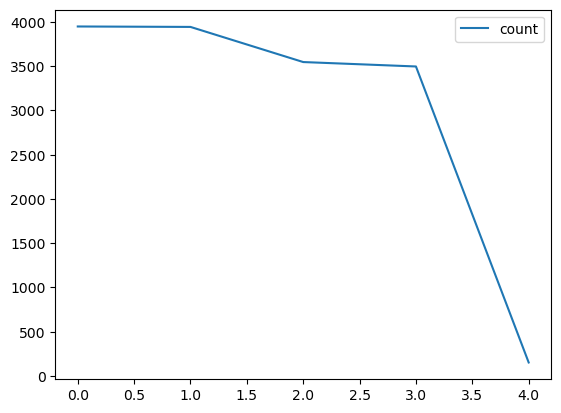

In [20]:
direction_count.plot()

<Axes: title={'center': 'Number of stops in each direction'}, xlabel='direction'>

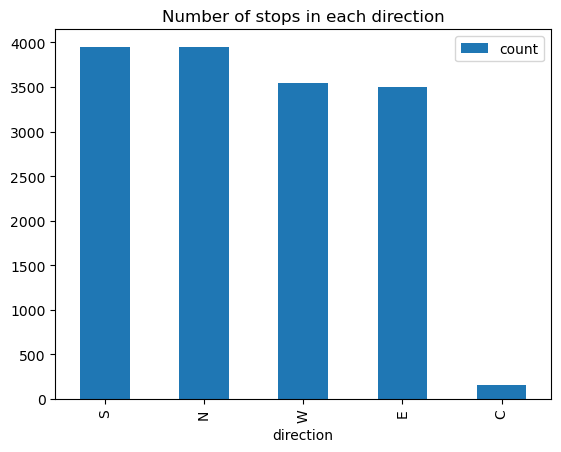

In [21]:
direction_count.plot.bar(x = 'direction', y = 'count', title = 'Number of stops in each direction')

In [22]:
metro.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 15089 entries, 0 to 15088
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   STOPNUM   15089 non-null  int64   
 1   LINE      15089 non-null  int64   
 2   DIR       15089 non-null  object  
 3   STOPNAME  15089 non-null  object  
 4   LAT       15089 non-null  float64 
 5   LONG      15089 non-null  float64 
 6   geometry  15089 non-null  geometry
dtypes: float64(2), geometry(1), int64(2), object(2)
memory usage: 825.3+ KB


In [23]:
metro[['STOPNUM','LINE','DIR','STOPNAME','LAT','LONG','geometry']]

,STOPNUM,LINE,DIR,STOPNAME,LAT,LONG,geometry
0,1,265,S,Paramount / Slauson,33.973248,-118.113113,POINT (-118.11311 33.97325)
1,3,35,N,Jefferson / 10th,34.025471,-118.328402,POINT (-118.32840 34.02547)
2,6,53,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
3,6,120,W,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
4,6,55,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
...,...,...,...,...,...,...,...
15084,70500033,258,S,Fremont / Ross,34.072110,-118.151947,POINT (-118.15195 34.07211)
15085,70500036,70,E,17th / Hill,34.034213,-118.265336,POINT (-118.26534 34.03421)
15086,72000002,720,W,Wilshire / Barrington,34.049454,-118.461158,POINT (-118.46116 34.04945)
15087,72000003,20,W,6th / Witmer,34.055547,-118.265321,POINT (-118.26532 34.05555)


In [24]:
desired_columns = ['LINE','DIR','STOPNAME','LAT','LONG','geometry']
metro[desired_columns].sample(5)

,LINE,DIR,STOPNAME,LAT,LONG,geometry
6549,164,W,Victory / Naomi,34.184701,-118.341385,POINT (-118.34139 34.18470)
9824,236,N,Rinaldi / Woodley,34.279056,-118.484815,POINT (-118.48481 34.27906)
1239,62,S,Olympic / Grande Vista,34.019879,-118.210203,POINT (-118.21020 34.01988)
12802,158,W,Woodman / Woodman,34.207028,-118.431087,POINT (-118.43109 34.20703)
3637,460,E,Rosecrans / Dinard,33.902303,-118.051064,POINT (-118.05106 33.90230)


In [25]:
metro_trimmed = metro[desired_columns].copy()
metro_trimmed

,LINE,DIR,STOPNAME,LAT,LONG,geometry
0,265,S,Paramount / Slauson,33.973248,-118.113113,POINT (-118.11311 33.97325)
1,35,N,Jefferson / 10th,34.025471,-118.328402,POINT (-118.32840 34.02547)
2,53,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
3,120,W,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
4,55,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
...,...,...,...,...,...,...
15084,258,S,Fremont / Ross,34.072110,-118.151947,POINT (-118.15195 34.07211)
15085,70,E,17th / Hill,34.034213,-118.265336,POINT (-118.26534 34.03421)
15086,720,W,Wilshire / Barrington,34.049454,-118.461158,POINT (-118.46116 34.04945)
15087,20,W,6th / Witmer,34.055547,-118.265321,POINT (-118.26532 34.05555)


In [26]:
metro_trimmed[metro_trimmed.DIR == 'E']

,LINE,DIR,STOPNAME,LAT,LONG,geometry
7,120,E,120th / Martin Luther King Hospital,33.924505,-118.240369,POINT (-118.24037 33.92451)
9,162,E,15054 Sherman Way,34.201075,-118.461953,POINT (-118.46195 34.20108)
15,33,E,2nd / Santa Monica,34.015028,-118.497346,POINT (-118.49735 34.01503)
16,16,E,3rd / Gardner,34.070240,-118.353264,POINT (-118.35326 34.07024)
18,4,E,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388)
...,...,...,...,...,...,...
15058,102,E,Western / Martin Luther King Jr,34.011272,-118.308753,POINT (-118.30875 34.01127)
15068,161,E,Agoura / Las Virgenes,34.143801,-118.698717,POINT (-118.69872 34.14380)
15072,134,E,22718 Pacific Coast Highway,34.039323,-118.669421,POINT (-118.66942 34.03932)
15075,70,E,Olive / General Thaddeus Kosciuszko,34.053257,-118.249154,POINT (-118.24915 34.05326)


In [27]:
metro_trimmed.loc[metro_trimmed['DIR']=='W']

,LINE,DIR,STOPNAME,LAT,LONG,geometry
3,120,W,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
19,720,W,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388)
21,20,W,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388)
23,4,W,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388)
24,10,W,Hill / 5th,34.048591,-118.251764,POINT (-118.25176 34.04859)
...,...,...,...,...,...,...
15078,78,W,Huntington / Collis,34.086205,-118.183982,POINT (-118.18398 34.08620)
15080,179,W,Huntington / Collis,34.086205,-118.183982,POINT (-118.18398 34.08620)
15086,720,W,Wilshire / Barrington,34.049454,-118.461158,POINT (-118.46116 34.04945)
15087,20,W,6th / Witmer,34.055547,-118.265321,POINT (-118.26532 34.05555)


In [28]:
metro_trimmed.query("DIR=='S'")

,LINE,DIR,STOPNAME,LAT,LONG,geometry
0,265,S,Paramount / Slauson,33.973248,-118.113113,POINT (-118.11311 33.97325)
5,53,S,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470)
8,55,S,120th / Martin Luther King Hospital,33.924505,-118.240369,POINT (-118.24037 33.92451)
11,106,S,1st / Eastern,34.036881,-118.173232,POINT (-118.17323 34.03688)
12,665,S,Indiana / Olympic,34.018999,-118.192361,POINT (-118.19236 34.01900)
...,...,...,...,...,...,...
15062,210,S,Western / Beverly,34.076041,-118.309289,POINT (-118.30929 34.07604)
15063,207,S,Western / Wilshire,34.061911,-118.309227,POINT (-118.30923 34.06191)
15064,207,S,Western / Manchester,33.959746,-118.309114,POINT (-118.30911 33.95975)
15070,105,S,La Cienega / 3rd,34.073195,-118.376636,POINT (-118.37664 34.07319)


<Axes: >

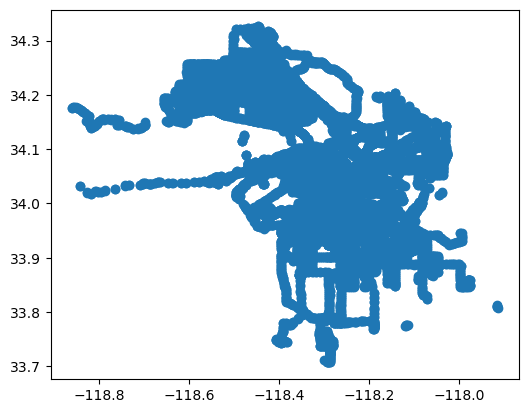

In [29]:
metro_trimmed.plot()

In [30]:
metro_trimmed.geometry

0        POINT (-118.11311 33.97325)
1        POINT (-118.32840 34.02547)
2        POINT (-118.24222 33.92470)
3        POINT (-118.24222 33.92470)
4        POINT (-118.24222 33.92470)
                    ...             
15084    POINT (-118.15195 34.07211)
15085    POINT (-118.26534 34.03421)
15086    POINT (-118.46116 34.04945)
15087    POINT (-118.26532 34.05555)
15088    POINT (-118.26532 34.05555)
Name: geometry, Length: 15089, dtype: geometry

<Axes: >

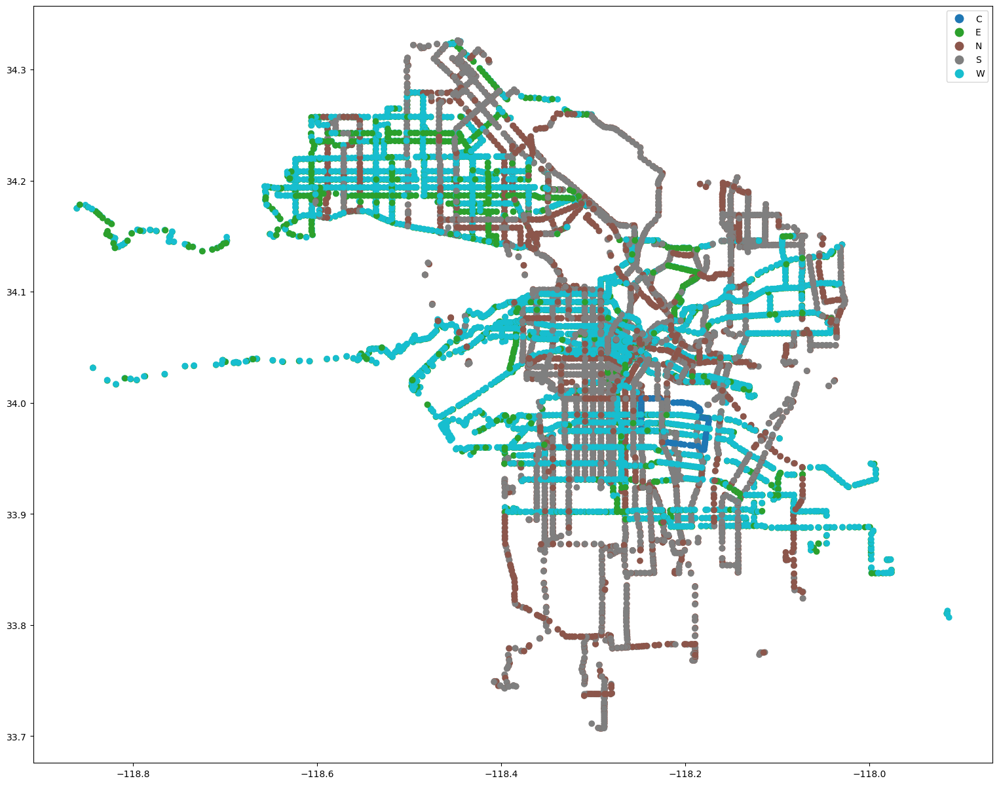

In [31]:
metro_trimmed.plot(
            figsize=(25,15),   
            column = 'DIR',  
            legend = True,               
            legend_kwds={
               'loc': 'upper right',
               'bbox_to_anchor':(1,1)
            }                
) 

In [32]:
import folium

In [33]:
m = folium.Map()
m

In [34]:
latitude = metro_trimmed.LAT.mean()
latitude

34.06204672178408

In [35]:
longitude = metro_trimmed.LONG.mean()
longitude

-118.30659774087084

In [36]:
m = folium.Map(location=[latitude,longitude])
m

In [37]:
for index, row in metro_trimmed.iterrows():
    print(row.STOPNAME, row.LAT, row.LONG)

Paramount / Slauson 33.973248 -118.113113
Jefferson / 10th 34.025471 -118.328402
120th / Augustus F Hawkins 33.924696 -118.242222
120th / Augustus F Hawkins 33.924696 -118.242222
120th / Augustus F Hawkins 33.924696 -118.242222
120th / Augustus F Hawkins 33.924696 -118.242222
120th / Martin Luther King Hospital 33.924505 -118.240369
120th / Martin Luther King Hospital 33.924505 -118.240369
120th / Martin Luther King Hospital 33.924505 -118.240369
15054 Sherman Way 34.201075 -118.461953
Riverside / Los Feliz 34.116932 -118.271486
1st / Eastern 34.036881 -118.173232
Indiana / Olympic 34.018999 -118.192361
226th / Norwalk 33.823987 -118.072255
226th / Norwalk 33.823987 -118.072255
2nd / Santa Monica 34.015028 -118.497346
3rd / Gardner 34.07024 -118.353264
Balboa / Foothill West Jog 34.322084 -118.495243
5th / Colorado 34.013884 -118.490199
5th / Colorado 34.013884 -118.490199
5th / Colorado 34.013884 -118.490199
5th / Colorado 34.013884 -118.490199
5th / Colorado 34.013884 -118.490199
5th

In [38]:
for index, row in metro_trimmed.iterrows():
    folium.Marker([row.LAT, row.LONG], popup=row.STOPNAME, tooltip=row.STOPNAME).add_to(m)
m

In [39]:
metro_trimmed['color'] = ''

In [40]:
metro_trimmed.head()

,LINE,DIR,STOPNAME,LAT,LONG,geometry,color
0,265,S,Paramount / Slauson,33.973248,-118.113113,POINT (-118.11311 33.97325),
1,35,N,Jefferson / 10th,34.025471,-118.328402,POINT (-118.32840 34.02547),
2,53,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470),
3,120,W,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470),
4,55,N,120th / Augustus F Hawkins,33.924696,-118.242222,POINT (-118.24222 33.92470),


In [41]:
metro_trimmed.DIR.unique()

array(['S', 'N', 'W', 'E', 'C'], dtype=object)

In [42]:
metro_trimmed.loc[metro_trimmed['DIR'] == 'E']

,LINE,DIR,STOPNAME,LAT,LONG,geometry,color
7,120,E,120th / Martin Luther King Hospital,33.924505,-118.240369,POINT (-118.24037 33.92451),
9,162,E,15054 Sherman Way,34.201075,-118.461953,POINT (-118.46195 34.20108),
15,33,E,2nd / Santa Monica,34.015028,-118.497346,POINT (-118.49735 34.01503),
16,16,E,3rd / Gardner,34.070240,-118.353264,POINT (-118.35326 34.07024),
18,4,E,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388),
...,...,...,...,...,...,...,...
15058,102,E,Western / Martin Luther King Jr,34.011272,-118.308753,POINT (-118.30875 34.01127),
15068,161,E,Agoura / Las Virgenes,34.143801,-118.698717,POINT (-118.69872 34.14380),
15072,134,E,22718 Pacific Coast Highway,34.039323,-118.669421,POINT (-118.66942 34.03932),
15075,70,E,Olive / General Thaddeus Kosciuszko,34.053257,-118.249154,POINT (-118.24915 34.05326),


In [43]:
metro_trimmed.loc[metro_trimmed['DIR'] == 'E', 'color'] = 'orange'

In [44]:
metro_trimmed.loc[metro_trimmed['DIR'] == 'E']

,LINE,DIR,STOPNAME,LAT,LONG,geometry,color
7,120,E,120th / Martin Luther King Hospital,33.924505,-118.240369,POINT (-118.24037 33.92451),orange
9,162,E,15054 Sherman Way,34.201075,-118.461953,POINT (-118.46195 34.20108),orange
15,33,E,2nd / Santa Monica,34.015028,-118.497346,POINT (-118.49735 34.01503),orange
16,16,E,3rd / Gardner,34.070240,-118.353264,POINT (-118.35326 34.07024),orange
18,4,E,5th / Colorado,34.013884,-118.490199,POINT (-118.49020 34.01388),orange
...,...,...,...,...,...,...,...
15058,102,E,Western / Martin Luther King Jr,34.011272,-118.308753,POINT (-118.30875 34.01127),orange
15068,161,E,Agoura / Las Virgenes,34.143801,-118.698717,POINT (-118.69872 34.14380),orange
15072,134,E,22718 Pacific Coast Highway,34.039323,-118.669421,POINT (-118.66942 34.03932),orange
15075,70,E,Olive / General Thaddeus Kosciuszko,34.053257,-118.249154,POINT (-118.24915 34.05326),orange


In [45]:
metro_trimmed.loc[metro_trimmed['DIR'] == 'S', 'color'] = 'blue'
metro_trimmed.loc[metro_trimmed['DIR'] == 'N', 'color'] = 'green'
metro_trimmed.loc[metro_trimmed['DIR'] == 'W', 'color'] = 'red'
metro_trimmed.loc[metro_trimmed['DIR'] == 'C', 'color'] = 'purple'

In [46]:
metro_trimmed.sample(5)

,LINE,DIR,STOPNAME,LAT,LONG,geometry,color
1636,206,N,Fountain / Vermont,34.095667,-118.291093,POINT (-118.29109 34.09567),green
13862,94,S,Magnolia / Biloxi,34.164805,-118.358421,POINT (-118.35842 34.16481),blue
12477,76,W,Valley / Abbot,34.079773,-118.102396,POINT (-118.10240 34.07977),red
13931,94,N,Magnolia / Hollywood Way,34.168053,-118.346824,POINT (-118.34682 34.16805),green
7390,167,E,Burbank / Coldwater,34.172026,-118.414307,POINT (-118.41431 34.17203),orange


In [49]:
m = folium.Map(location=[latitude,longitude], tiles='CartoDB Positron', zoom_start=10)

In [ ]:
for index, row in metro_trimmed.iterrows():
    tooltip_text = row.DIR + 'Direction:' + row.STOPNAME
    folium.Marker(
        [row.LAT,row.LONG], 
        popup=row.STOPNAME, 
        tooltip=tooltip_text,
        icon=folium.Icon(color=row.color)
    ).add_to(m)
m

In [ ]:
m.save('motro.html')